#### Laboratorium 10 - zadania

Detektor obiektów oparty na HOG co do zasady działania przypomina znany Ci już detektor Viola-Jones:
* dla każdego potencjalnego rejonu zainteresowania:
* ekstrahujemy cechy za pomocą deskryptora HOG,
* wykorzystujemy jakiś klasyfikator (np. SVM) do wykonania predykcji,
* zapisujemy znalezione wystąpienia obiektów.

Ponieważ na dzisiejszych zajęciach nie będziemy mieli czasu ani zasobów na nikopoziomowe odtworzenie całej ścieżki z takim detektorem, skupimy się najpierw na samym deskryptorze a potem przetestujemy gotowy detektor.

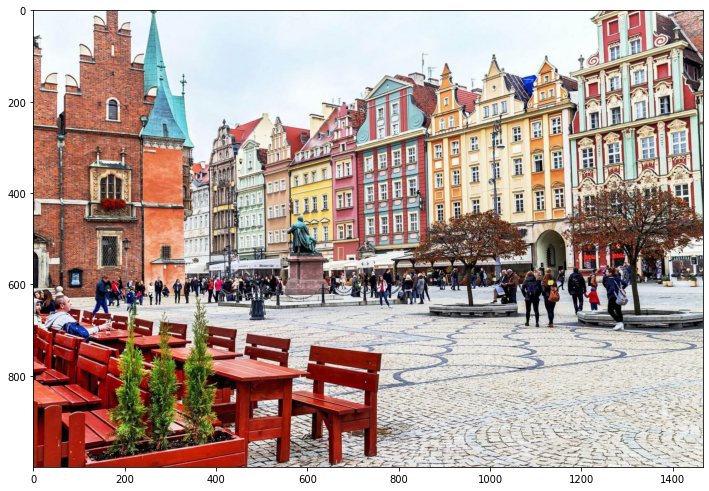

In [1]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
from PIL import Image

rynek = cv2.imread('rynek.jpg')
plt.subplots(1, 1, figsize=(12, 12))[1].imshow(rynek[..., ::-1]);

Przykładowe rejony zainteresowania, dane jako koordynaty punktów stanowiący lewy-górny narożnik prostokąta o wymiarach 64x128:

In [2]:
# pozytywne
xy1 = (1058, 567)
xy2 = (1155, 550)
# negatywne
xyN = (656, 752)

#### Zadanie 1 (2.0 pkt | 1.0 pkt)

W tym zadaniu przećwiczysz (w niewielkim uproszczeniu) podstawową koncepcję detektora HOG. Kroki a-c powtórz dla różnych ROI, porównując wyniki.

#### Zadanie 1a (0.5 pkt | 0.0 pkt)

Wykonaj obrazy gradientów dla wybranego ROI a następnie przekształć je do postaci biegunowej. Pamiętaj o konwersji do skali szarości.

In [3]:
rynek.shape

(1000, 1466, 3)

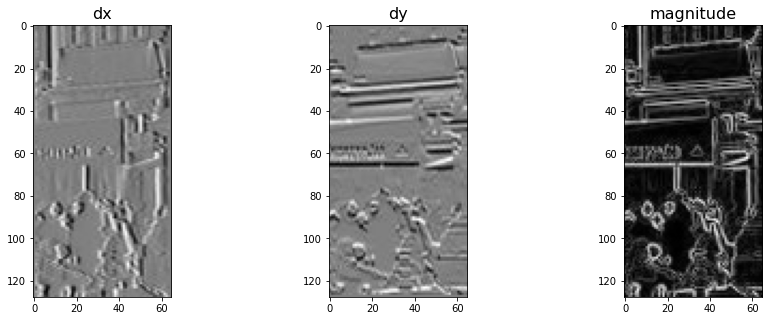

In [9]:
def show_gradients(roi, plot=False):
    roi_gray = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    gx = cv2.Sobel(roi_gray, cv2.CV_32F, 1, 0, ksize=1)
    gy = cv2.Sobel(roi_gray, cv2.CV_32F, 0, 1, ksize=1)
    mag, ang = cv2.cartToPolar(gx, gy, angleInDegrees=True)
#             return roi

    if plot:
        fig, ax = plt.subplots(1,3,figsize=(15,5));
        ax[0].imshow(gx, cmap='gray');
        ax[0].set_title('dx', fontsize=16)
        ax[1].imshow(gy, cmap='gray');
        ax[1].set_title('dy', fontsize=16);
        ax[2].imshow(mag, cmap='gray');
        ax[2].set_title('magnitude', fontsize=16)
    

show_gradients(rynek[500:628, 500:565], plot=True)
plt.savefig('zad1v1.png')

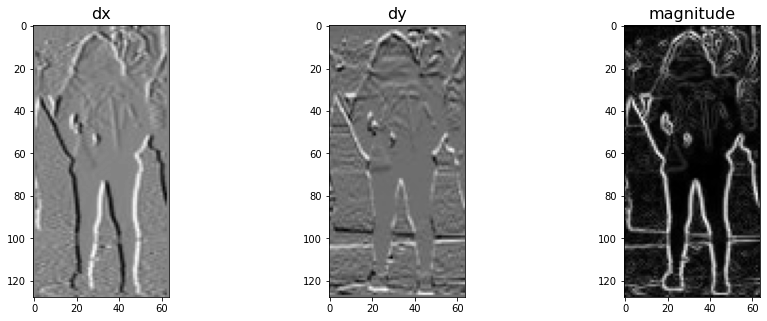

In [10]:
show_gradients(rynek[567:567+128, 1058:1058+64], plot=True)
plt.savefig('zad1v2.png')

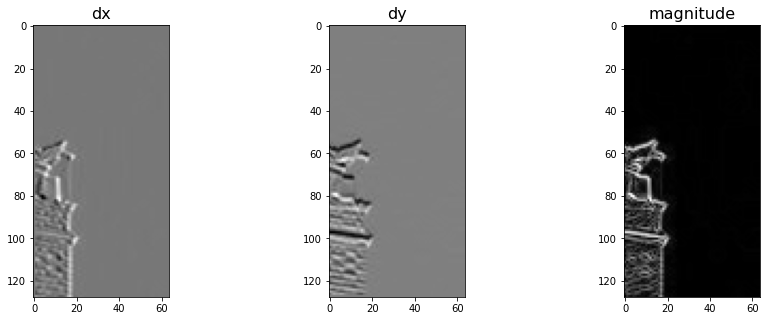

In [6]:
show_gradients(rynek[0:128, 0:64], plot=True)

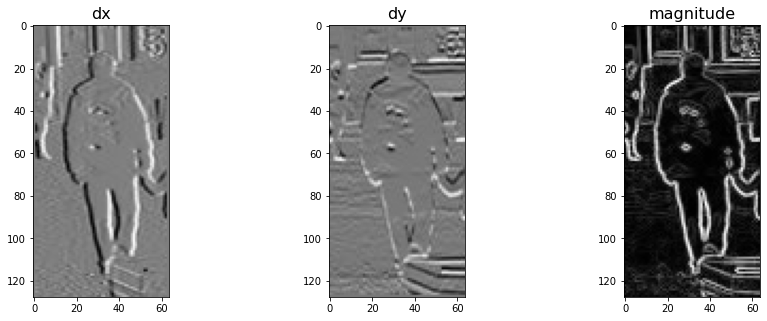

In [7]:
show_gradients(rynek[550:678, 1155:1155+64], plot=True)

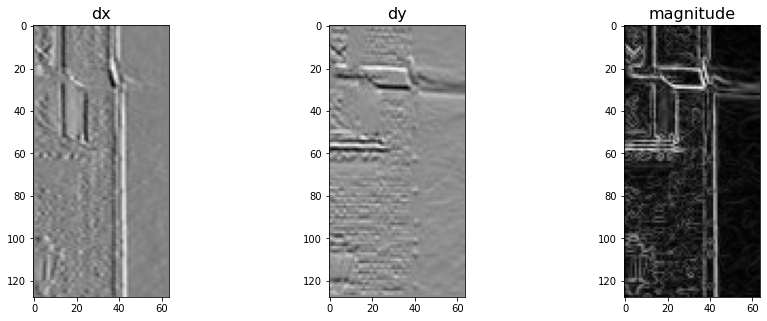

In [8]:
show_gradients(rynek[400:528, 200:264], plot=True)

#### Zadanie 1b (1.0 pkt | 0.5 pkt)

Wykorzystując podany fragment do iteracji po "komórkach" obrazu, znajdź dominujący kierunek gradientu w każdej komórce. Możesz, ale nie musisz stosować finezyjnej interpolacji w zgodzie z literaturą.

In [11]:
def get_cell(image:np.ndarray, cx:int, cy:int):
    return image[cy*8:cy*8+8, cx*8:cx*8+8]

In [15]:
from copy import deepcopy 
from tqdm.auto import tqdm

def scale_angles(angle):
    over_180 = angle >= 180
    angle[over_180] = 360 - angle[over_180]
    
    return angle

def get_gradients(cell, cvtToGray = False):
    roi = deepcopy(cell)
    if cvtToGray:
        roi = cv2.cvtColor(roi, cv2.COLOR_BGR2GRAY)
    
    gx = cv2.Sobel(roi, cv2.CV_32F, 1, 0, ksize=1)
    gy = cv2.Sobel(roi, cv2.CV_32F, 0, 1, ksize=1)
    mag, ang = cv2.cartToPolar(gx, gy, angleInDegrees=True)
    ang = scale_angles(ang)
    return mag, ang

def create_buckets(buckets_num):
    buckets = np.linspace(20, 180, num = buckets_num, endpoint = True)
    
    return buckets

def get_dominant_angle(buckets, histogram):
    bin_id = np.argmax(histogram)
    dominant_angle = buckets[bin_id] - 10.0
    
    return dominant_angle

def cell_histogram(cell, buckets):
    
    bins = np.zeros((buckets.size))
    mag, ang = get_gradients(cell)
    
    mag_f = mag.flatten()
    ang_f = ang.flatten()
    
    for i, ang_v in enumerate(ang_f):
        mag_v = mag_f[i]
        
        diff = np.abs(ang_v - buckets)
        
        if ang_v < buckets[0]:
            first_bin_idx = 0
            second_bin_idx = buckets.size - 1
        elif ang_v > buckets[-1]:
            first_bin_idx = buckets.size - 1
            second_bin_idx = 0
        else:
            first_bin_idx = np.where(diff == np.min(diff))[0][0]
            temp = buckets[[(first_bin_idx-1) % buckets.size, (first_bin_idx+1) % buckets.size]]
            temp2 = np.abs(ang_v - temp)
            res = np.where(temp2 == np.min(temp2))[0][0]
            if res == 0 and first_bin_idx != 0:
                second_bin_idx = first_bin_idx - 1
            else:
                second_bin_idx = first_bin_idx + 1
        
        first_bin_value = buckets[first_bin_idx]
        second_bin_value = buckets[second_bin_idx]
        
        bins[first_bin_idx] = bins[first_bin_idx] + (np.abs(ang_v - first_bin_value)/(180.0/buckets.size)) * mag_v
        bins[second_bin_idx] = bins[second_bin_idx] + (np.abs(ang_v - second_bin_value)/(180.0/buckets.size)) * mag_v
    return bins
    
def get_dominant_angles(img):
    img_gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    dominating = np.zeros((img_gray.shape[0] // 8, img_gray.shape[1] // 8))
    buckets = create_buckets(9)
    
    dominating_values = []
    
    for y in tqdm(range(img_gray.shape[0] // 8)):
        for x in range(img_gray.shape[1] // 8):
            cell = get_cell(img_gray, x, y)
            histogram = cell_histogram(cell, buckets)
            dominant_angle = get_dominant_angle(buckets, histogram)
            dominating[y, x] = dominant_angle
            dominating_values.append(dominant_angle)
            
    return dominating, dominating_values
    

In [16]:
# dom, dom_values = get_dominant_angles(rynek)

In [17]:
dom.shape

(125, 183)

#### Zadanie 1c (0.5 pkt | 0.5pkt)

Poniższy snippet rysuje linię o podanym kierunku w podanej komórce. Utwórz za jego pomocą wykres dominujących kierunków na przestrzeni obrazu. Tip: skonwertuj obraz do skali szarości i rysuj linie jaskrawym kolorem dla lepszej widoczności.

In [18]:
import math
def draw_orientation(cell, angle, color):
    d = 3.5
    lca = d * np.cos(math.radians(angle))
    lsa = d * np.sin(math.radians(angle))
    p1 = int(3 - lca), int(3 - lsa)
    p2 = int(3 + lca), int(3 + lsa)
    cv2.line(cell, p1, p2, color=color, thickness=1)
    return cell

In [22]:
from copy import copy
def draw_dominating_angles(image, figsize=(24,24)):
    angles, dom_angles = get_dominant_angles(image)
    buckets = create_buckets(9)
    img = copy(image)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    img = cv2.cvtColor(img, cv2.COLOR_GRAY2RGB)
    for y in range(0, img.shape[0] // 8):
        for x in range(0, img.shape[1] // 8):
            cell = get_cell(img, x, y)
            draw_orientation(cell, angles[y, x], (255, 0, 0))
            
    fig, ax = plt.subplots(1,2, figsize=(12,5))
    ax[0].imshow(img);
    ax[0].set_title('Dominujące kierunki gradientów w komórkach', fontsize=16)
    ax[1].hist(dom_angles, buckets)
    ax[1].set_title('Histogram dominujących kierunków', fontsize=16)
    plt.tight_layout()

  0%|          | 0/62 [00:00<?, ?it/s]

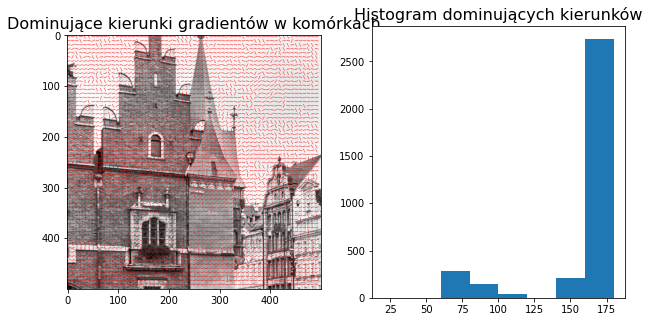

In [21]:
draw_dominating_angles(rynek[0:500,0:500])

  0%|          | 0/16 [00:00<?, ?it/s]

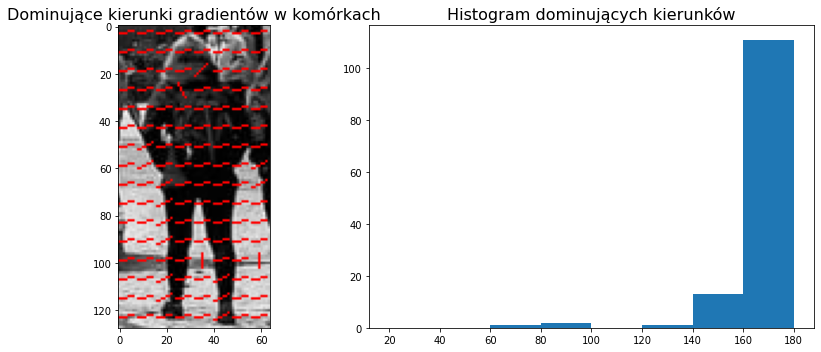

In [32]:
draw_dominating_angles(rynek[567:567+128, 1058:1058+64], (7,7))
plt.savefig('zad2v1.png')

  0%|          | 0/16 [00:00<?, ?it/s]

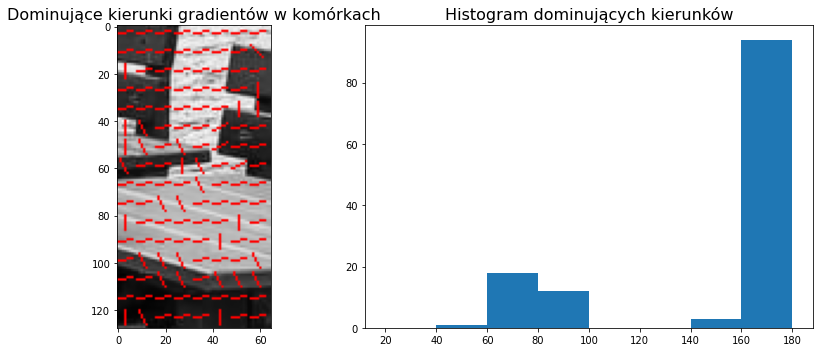

In [33]:
draw_dominating_angles(rynek[700:828, 420:485], (7,7))
plt.savefig('zad2v2.png')

  0%|          | 0/16 [00:00<?, ?it/s]

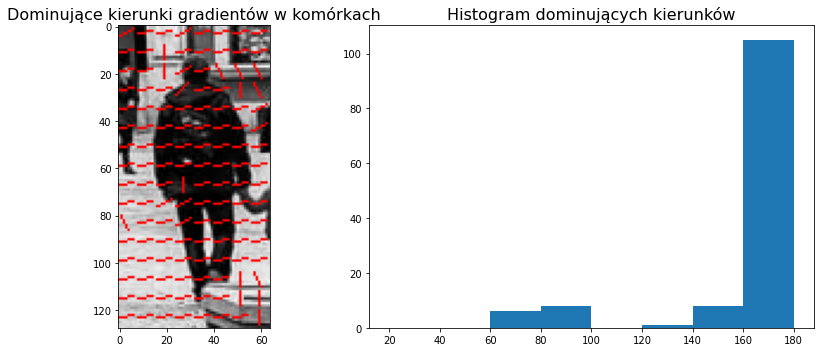

In [25]:
draw_dominating_angles(rynek[550:678, 1155:1155+64], (7,7))

  0%|          | 0/125 [00:00<?, ?it/s]

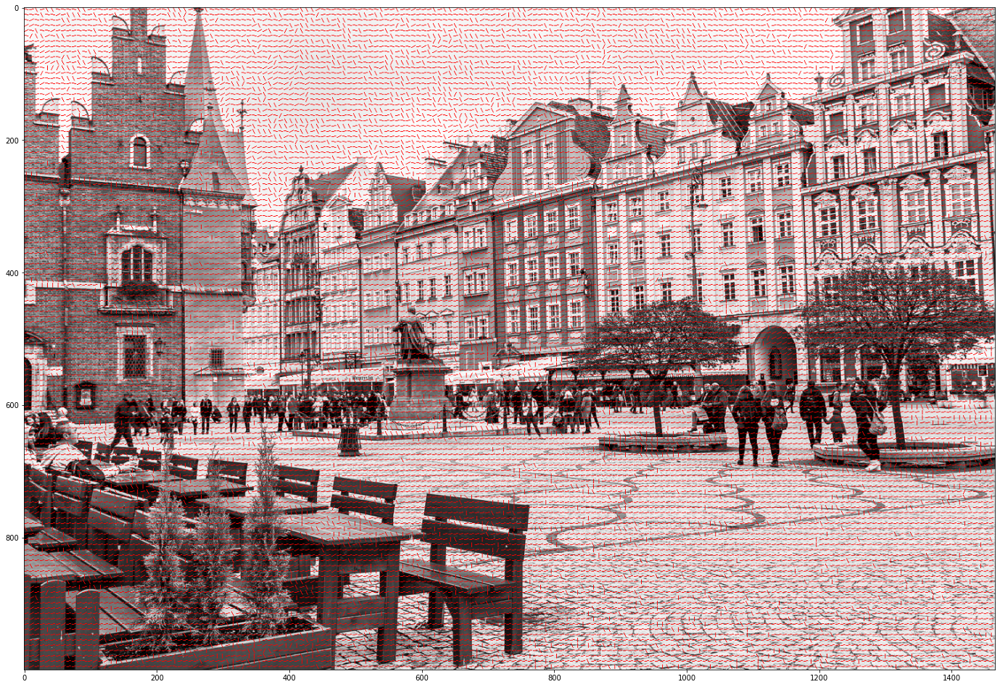

In [19]:
draw_dominating_angles(rynek)

---

#### Zadanie 2 (1.0 pkt | 1.0 pkt)

Przetestuj implementację **detektora** HOG z OpenCV na dołączonych obrazach (`rynek` i `ulica`). Domyślny konstruktor [cv2.HOGDetector](https://docs.opencv.org/4.x/d5/d33/structcv_1_1HOGDescriptor.html#a5c8e8ce0578512fe80493ed3ed88ca83) tworzy detektor wg parametryzacji z oryginalnej publikacji - pozostań przy tych wartościach.

Pamiętaj, że detektor HOG integruje deskryptor (metoda [`compute`](https://docs.opencv.org/4.x/d5/d33/structcv_1_1HOGDescriptor.html#a38cd712cd5a6d9ed0344731fcd121e8b)) oraz bazujący na podejściu sliding-window i klasyfikatorze SVM detektor (metoda [`detect`](https://docs.opencv.org/4.x/d5/d33/structcv_1_1HOGDescriptor.html#a5851df61c5b95391533144c078403672) i podobne).

Aby uzyskać podstawowy detektor wstępnie nauczony detekcji sylwetek, możesz uzyskać domyślne parametry klasyfikatora za pomocą funkcji [`cv2.HOGDescriptor_getDefaultPeopleDetector`](https://docs.opencv.org/4.x/d5/d33/structcv_1_1HOGDescriptor.html#a9c7a0b2aa72cf39b4b32b3eddea78203) i załadować je do instancji HOGa za pomocą metody [`setSVMDetector`](https://docs.opencv.org/4.x/d5/d33/structcv_1_1HOGDescriptor.html#a6de5ac55631eed51e36278cde3a2c159).

Pytania: *skąd się biorą fałszywe pozytywy?*, *jaki jest wpływ skali?*

Jeśli starczy czasu: zapoznaj się i przetestuj metodę [`detectMultiScale`](https://docs.opencv.org/4.x/d5/d33/structcv_1_1HOGDescriptor.html#a91e56a2c317392e50fbaa2f5dc78d30b).

In [34]:
ulica = cv2.imread('ulica.jpg')

NEW DIM:  (1466, 1000)
NUMBER OF BOXES:  5


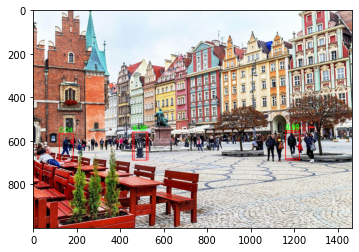

In [41]:
def run_hog(img ,scale_percent = 100):
    image = deepcopy(img)
    
    
    width = int(image.shape[1] * scale_percent / 100)
    height = int(image.shape[0] * scale_percent / 100)
    dim = (width, height)
    print('NEW DIM: ', dim)
    
    image = cv2.resize(image, dim, interpolation = cv2.INTER_AREA)
 
    img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    hog = cv2.HOGDescriptor()
    hog.setSVMDetector(cv2.HOGDescriptor.getDefaultPeopleDetector())
    
    
    bboxes, confidence = hog.detect(img_gray)
    print('NUMBER OF BOXES: ', len(bboxes))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    for i, left_top in enumerate(bboxes):
        x,y = left_top
        w,h = 64, 128
        bottom_right = (x+w, y+h)
        
        confidence_value = '{0:.2f}'.format(confidence[i][0])
        cv2.rectangle(image, left_top, bottom_right, (255, 0, 0), 2)
        cv2.putText(image, confidence_value ,(x, y - 10) , cv2.FONT_HERSHEY_SIMPLEX, 0.9, (36,255,12), 2)
#     plt.subplots(1, 1, figsize=(10,10))[1].imshow(image);
    plt.imshow(image)
run_hog(rynek)
plt.savefig('zad3v1.png')

NEW DIM:  (1172, 800)
NUMBER OF BOXES:  11


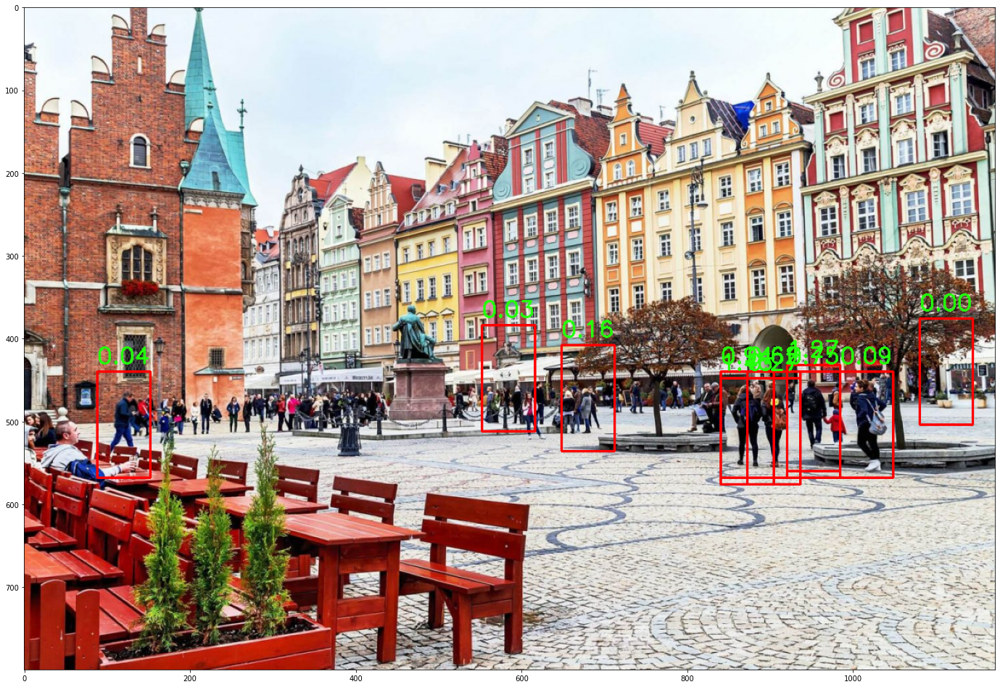

In [22]:
run_hog(rynek, 80)

NEW DIM:  (733, 500)
NUMBER OF BOXES:  0


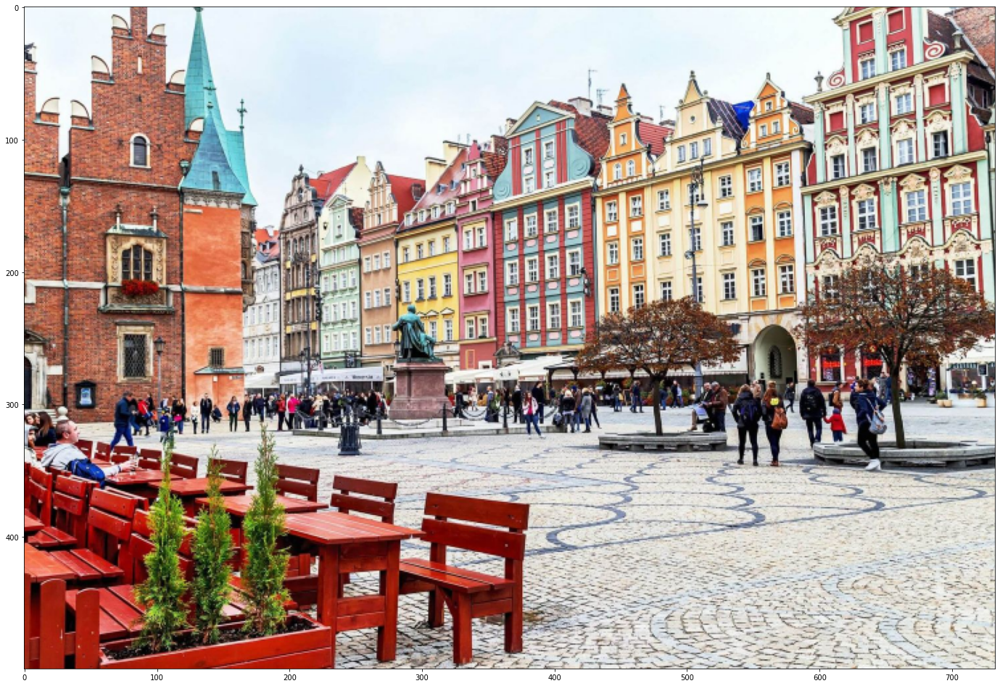

In [23]:
run_hog(rynek, 50)

NEW DIM:  (952, 650)
NUMBER OF BOXES:  4


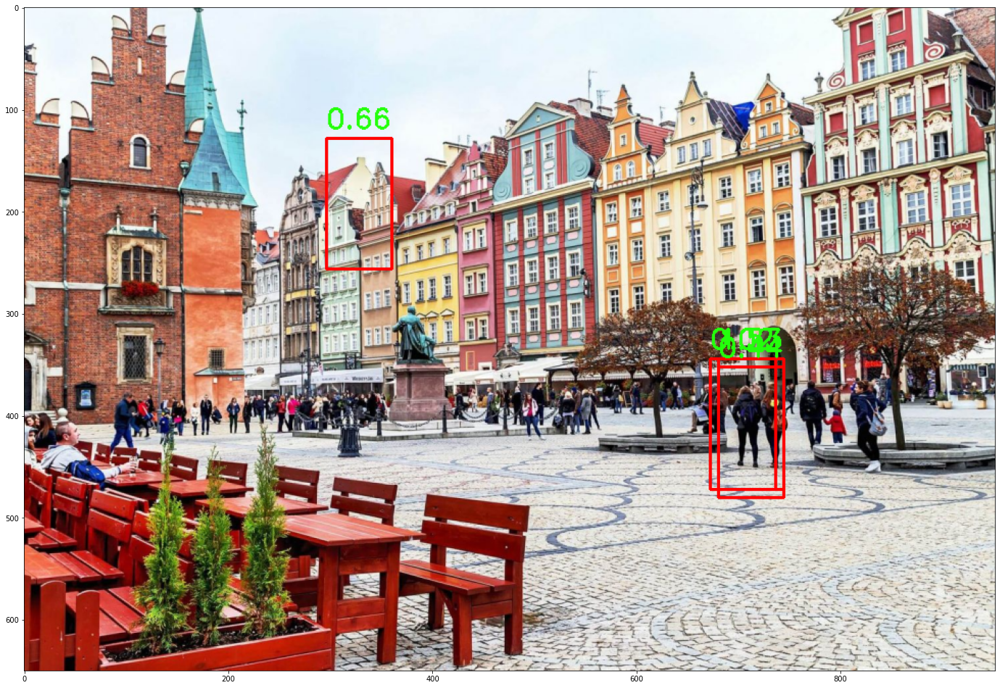

In [24]:
run_hog(rynek, 65)

NEW DIM:  (1026, 700)
NUMBER OF BOXES:  10


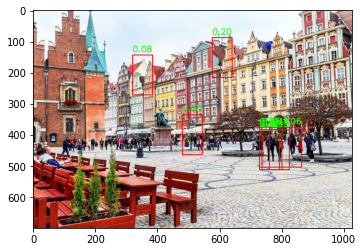

In [42]:
run_hog(rynek, 70)
plt.savefig('zad3v2.png')

NEW DIM:  (1024, 684)
NUMBER OF BOXES:  9


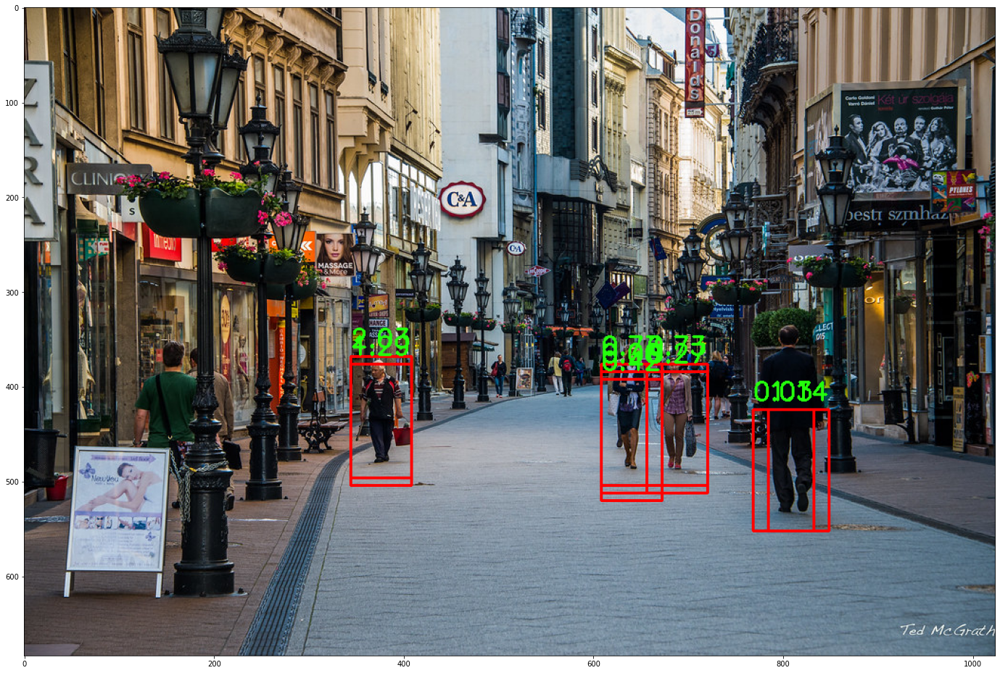

In [26]:
run_hog(ulica)

NEW DIM:  (716, 478)
NUMBER OF BOXES:  8


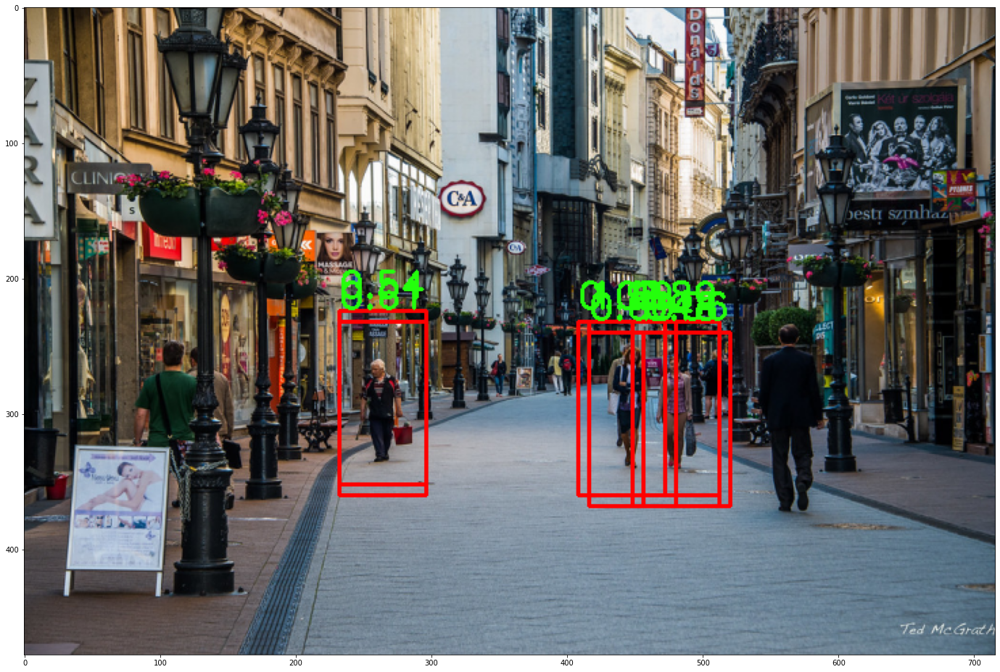

In [27]:
run_hog(ulica, 70)

NEW DIM:  (614, 410)
NUMBER OF BOXES:  7


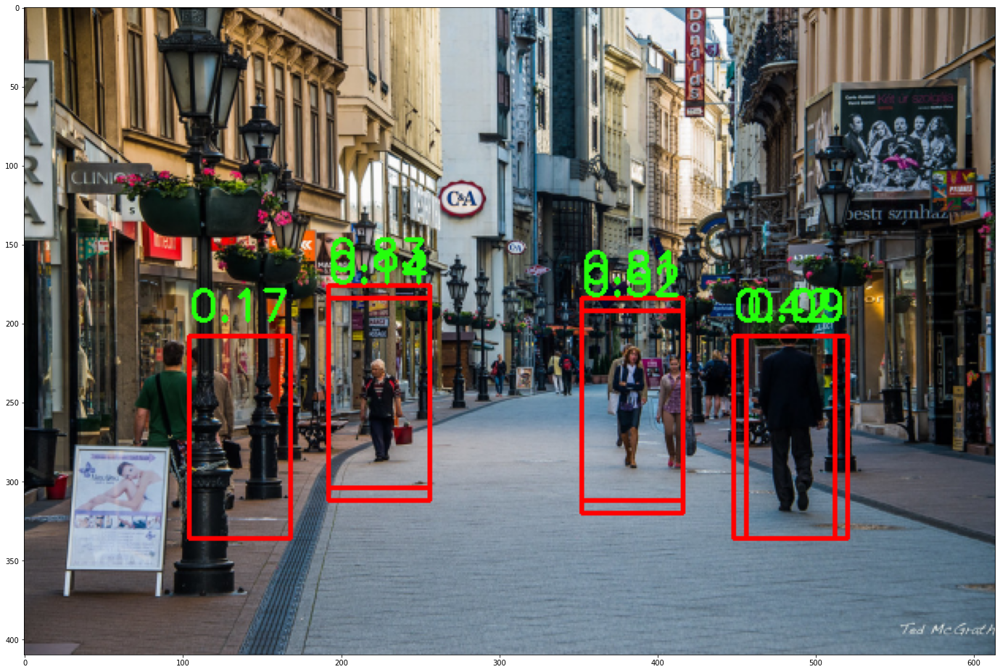

In [31]:
run_hog(ulica, 60)

NEW DIM:  (563, 376)
NUMBER OF BOXES:  8


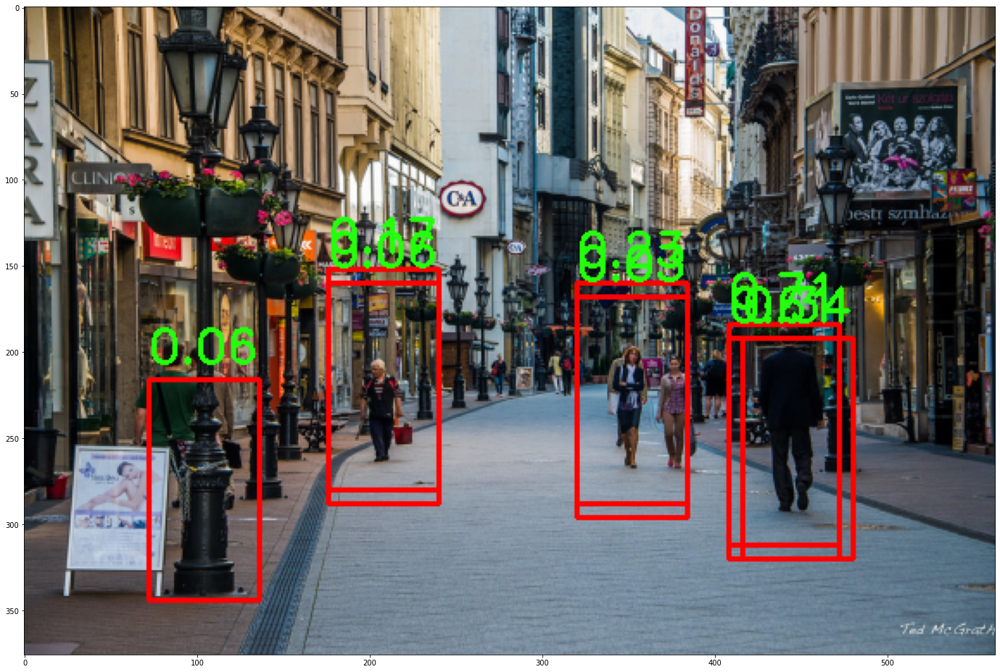

In [35]:
run_hog(ulica, 55)

In [28]:
def run_hod_multiscale(img):
    image = deepcopy(img)
 
    img_gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    hog = cv2.HOGDescriptor()
    hog.setSVMDetector(cv2.HOGDescriptor.getDefaultPeopleDetector())
    
    
    (rects, weights) = hog.detectMultiScale(img_gray)
    
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    
    for (x,y,w,h) in rects:
        cv2.rectangle(image, (x,y), (x+w, y+h), (255, 0, 0), 2)
        
    
    plt.subplots(1, 1, figsize=(24,24))[1].imshow(image);

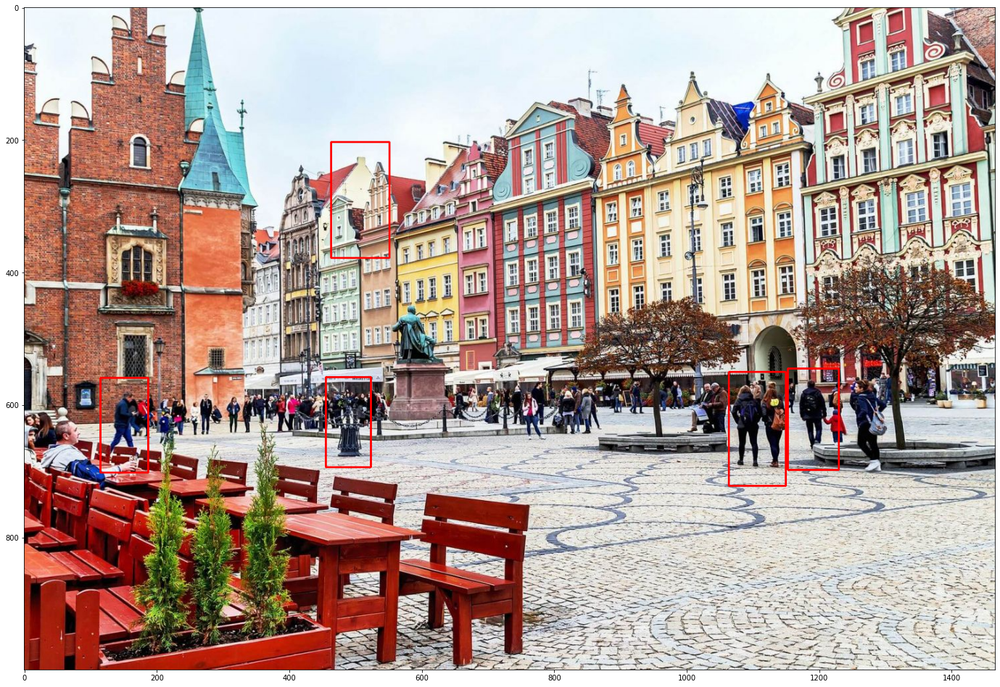

In [29]:
run_hod_multiscale(rynek)

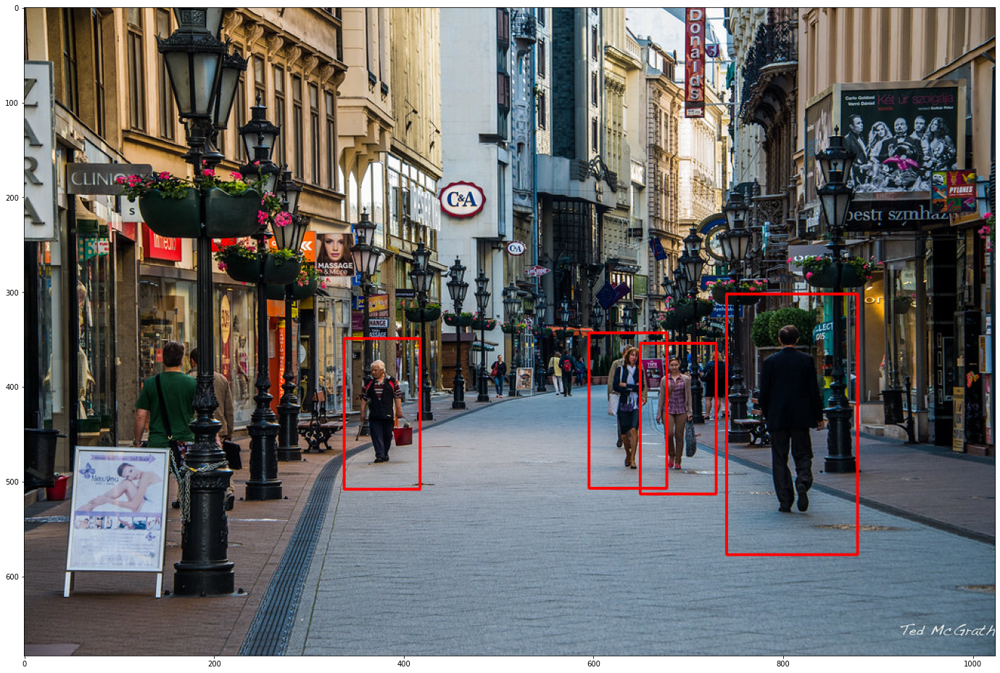

In [36]:
run_hod_multiscale(ulica)